<a href="https://colab.research.google.com/github/Saadullah45/Class-Imbalance-Final-project/blob/main/Impact_of_distance_functions_and_k_mediods.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ML- Assignment K-means Clustering

## Farjad Ahmed - 29405
## Saad ullah - 29416

In [55]:
!pip install kmodes
!pip install gower
!pip install kmodes
!pip install scikit-learn-extra


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 8.1 MB/s eta 0:00:00


In [4]:
import numpy as np
import pandas as pd

from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from ydata_profiling import ProfileReport

import warnings

# Ignore all warnings
warnings.filterwarnings('ignore')


In [5]:
import pandas as pd

import os

# Function to get data from UCI repository or local file
def get_data(id=None, file_path=None):
    if id is not None:
        # Fetch data from UCI repository
        data = fetch_ucirepo(id=id)
        X = data.data.features
        y = data.data.targets
        df = pd.merge(X, y, left_index=True, right_index=True)
        target = y.columns[0]

    elif file_path is not None:
        # Load data from local file
        if file_path.endswith('.csv'):
            df = pd.read_csv(file_path)
        elif file_path.endswith('.xlsx'):
            df = pd.read_excel(file_path)
        else:
            raise ValueError("Unsupported file format. Please use .csv or .xlsx.")

        # Assuming the last column is the target
        target = df.columns[-1]

    else:
        raise ValueError("Please provide either a UCI dataset ID or a file path.")

    return df, target

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Set the file path to your dataset
file_path = "/content/drive/My Drive/flight satisfaction train.csv"  # Adjust the file name if necessary

# Get the data
df, target = get_data(file_path=file_path)

# Display the DataFrame and target column name
print(df.head())
print("Target column:", target)


Mounted at /content/drive
   Unnamed: 0      id  Gender      Customer Type  Age   Type of Travel  \
0           0   70172    Male     Loyal Customer   13  Personal Travel   
1           1    5047    Male  disloyal Customer   25  Business travel   
2           2  110028  Female     Loyal Customer   26  Business travel   
3           3   24026  Female     Loyal Customer   25  Business travel   
4           4  119299    Male     Loyal Customer   61  Business travel   

      Class  Flight Distance  Inflight wifi service  \
0  Eco Plus              460                      3   
1  Business              235                      3   
2  Business             1142                      2   
3  Business              562                      2   
4  Business              214                      3   

   Departure/Arrival time convenient  ...  Inflight entertainment  \
0                                  4  ...                       5   
1                                  2  ...                   

In [7]:
profile = ProfileReport(df, title="EDA Report", explorative=True)
profile.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
df.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


In [7]:
df.shape


(103904, 25)

In [8]:
df.describe()


,Unnamed: 0,id,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
count,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103594.000000
mean,51951.500000,64924.210502,39.379706,1189.448375,2.729683,3.060296,2.756901,2.976883,3.202129,3.250375,3.439396,3.358158,3.382363,3.351055,3.631833,3.304290,3.640428,3.286351,14.815618,15.178678
std,29994.645522,37463.812252,15.114964,997.147281,1.327829,1.525075,1.398929,1.277621,1.329533,1.349509,1.319088,1.332991,1.288354,1.315605,1.180903,1.265396,1.175663,1.312273,38.230901,38.698682
min,0.000000,1.000000,7.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,25975.750000,32533.750000,27.000000,414.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,51951.500000,64856.500000,40.000000,843.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000
75%,77927.250000,97368.250000,51.000000,1743.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000
max,103903.000000,129880.000000,85.000000,4983.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000


# Summary

### Arrival Delay Column:
- **Minimum Arrival Delay**: 0 (indicating no delay).
- **Maximum Arrival Delay**: 1584.

### Flight Distance Column:
- **Shortest Flight Distance**: 31.
- **Longest Flight Distance**: 4983.

### Departure Delay Column:
- **Minimum Departure Delay**: 0.
- **Maximum Departure Delay**: 1592.

### Note:
There appear to be **outliers** in the data, as there is a significant difference between the third quartile (Q3) and the maximum value.
mum value.

In [9]:
def null_summary(df):
    null_counts = df.isnull().sum().to_frame('Missing Values')
    return null_counts.style.applymap(lambda v: 'background-color: #E3F2FD' if v > 0 else 'background-color: white')
null_summary(df)

,Missing Values
Unnamed: 0,0
id,0
Gender,0
Customer Type,0
Age,0
Type of Travel,0
Class,0
Flight Distance,0
Inflight wifi service,0
Departure/Arrival time convenient,0


In [11]:
df.duplicated().sum()
df = df.drop(columns=['Unnamed: 0'])


# Finding
- Dataset contains 103904 rows and 25 columns
- there are 310 missing values in **Arrival Delay in Minutes** column
-
There is missing values Arrival Delay column (310 missing values) i will impute it with media
- .
The first column (ID) and (Unnamed) columns seem useless and would not affect the analys
- s.
No duplicates were found in the dataset.

In [12]:
# Replace missing values with the median
df['Arrival Delay in Minutes'] = df['Arrival Delay in Minutes'].fillna(df['Arrival Delay in Minutes'].median())



In [13]:
def null_summary(df):
    null_counts = df.isnull().sum().to_frame('Missing Values')
    return null_counts.style.applymap(lambda v: 'background-color: #E3F2FD' if v > 0 else 'background-color: white')
null_summary(df)

,Missing Values
id,0
Gender,0
Customer Type,0
Age,0
Type of Travel,0
Class,0
Flight Distance,0
Inflight wifi service,0
Departure/Arrival time convenient,0
Ease of Online booking,0


In [14]:
import pandas as pd
from IPython.display import display

# Function to separate numeric and categorical columns
def display_column_types(df):
    # Get numeric columns
    numeric_columns = df.select_dtypes(include=['number']).columns.tolist()

    # Get categorical columns
    categorical_columns = df.select_dtypes(include=['object', 'category']).columns.tolist()

    # Create a DataFrame to display
    column_data = pd.DataFrame({
        'Numeric Columns': pd.Series(numeric_columns),
        'Categorical Columns': pd.Series(categorical_columns)
    })

    return column_data

# Example: Assuming df is your dataset
column_table = display_column_types(df)

# Fill empty cells with empty strings
column_table.fillna('', inplace=True)

# Display the table with better styling in Jupyter
styled_table = column_table.style.set_properties(**{'text-align': 'left'}).set_table_styles({
    'Numeric Columns': [{'selector': 'th', 'props': [('background-color', '#ADD8E6')]}],
    'Categorical Columns': [{'selector': 'th', 'props': [('background-color', '#FFD700')]}],
})

# Render the styled table without showing the index
display(styled_table)

# Optionally, display it without index as a standard DataFrame
display(column_table.to_html(index=False))


,Numeric Columns,Categorical Columns
0,id,Gender
1,Age,Customer Type
2,Flight Distance,Type of Travel
3,Inflight wifi service,Class
4,Departure/Arrival time convenient,satisfaction
5,Ease of Online booking,
6,Gate location,
7,Food and drink,
8,Online boarding,
9,Seat comfort,


'<table border="1" class="dataframe">\n  <thead>\n    <tr style="text-align: right;">\n      <th>Numeric Columns</th>\n      <th>Categorical Columns</th>\n    </tr>\n  </thead>\n  <tbody>\n    <tr>\n      <td>id</td>\n      <td>Gender</td>\n    </tr>\n    <tr>\n      <td>Age</td>\n      <td>Customer Type</td>\n    </tr>\n    <tr>\n      <td>Flight Distance</td>\n      <td>Type of Travel</td>\n    </tr>\n    <tr>\n      <td>Inflight wifi service</td>\n      <td>Class</td>\n    </tr>\n    <tr>\n      <td>Departure/Arrival time convenient</td>\n      <td>satisfaction</td>\n    </tr>\n    <tr>\n      <td>Ease of Online booking</td>\n      <td></td>\n    </tr>\n    <tr>\n      <td>Gate location</td>\n      <td></td>\n    </tr>\n    <tr>\n      <td>Food and drink</td>\n      <td></td>\n    </tr>\n    <tr>\n      <td>Online boarding</td>\n      <td></td>\n    </tr>\n    <tr>\n      <td>Seat comfort</td>\n      <td></td>\n    </tr>\n    <tr>\n      <td>Inflight entertainment</td>\n      <td></

# For Numerical columns


Histogram and Box Plot - Age


<Figure size 1000x600 with 0 Axes>

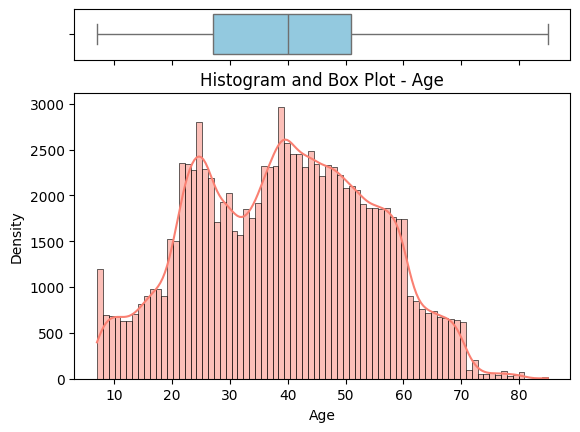


Histogram and Box Plot - Flight Distance


<Figure size 1000x600 with 0 Axes>

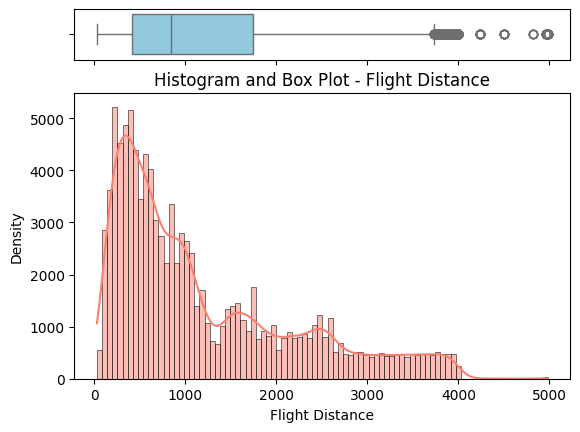


Histogram and Box Plot - Inflight wifi service


<Figure size 1000x600 with 0 Axes>

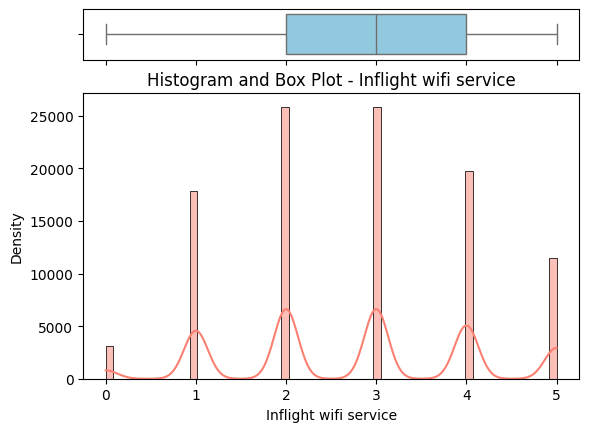


Histogram and Box Plot - Departure/Arrival time convenient


<Figure size 1000x600 with 0 Axes>

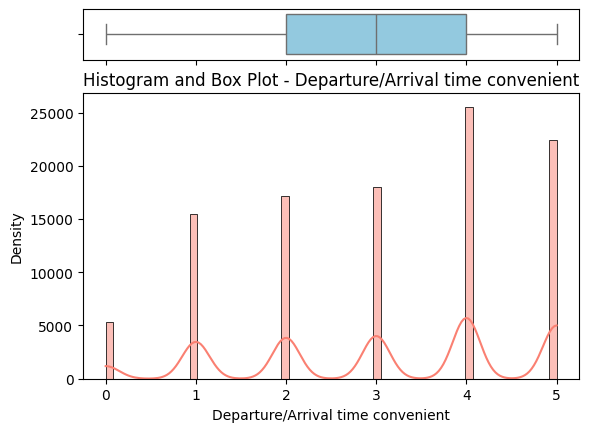


Histogram and Box Plot - Ease of Online booking


<Figure size 1000x600 with 0 Axes>

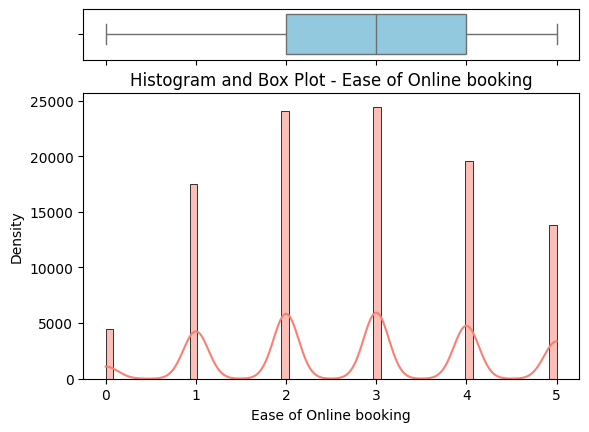


Histogram and Box Plot - Gate location


<Figure size 1000x600 with 0 Axes>

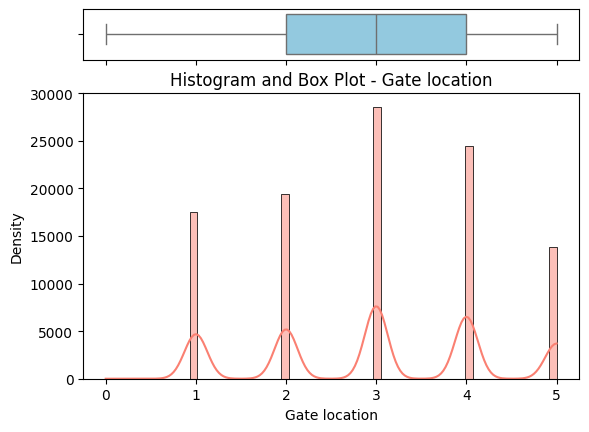


Histogram and Box Plot - Food and drink


<Figure size 1000x600 with 0 Axes>

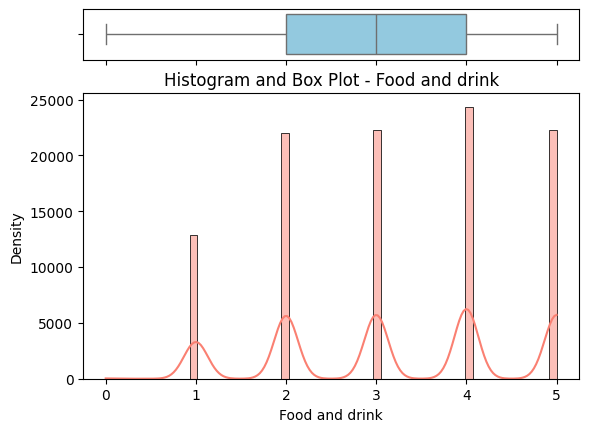


Histogram and Box Plot - Online boarding


<Figure size 1000x600 with 0 Axes>

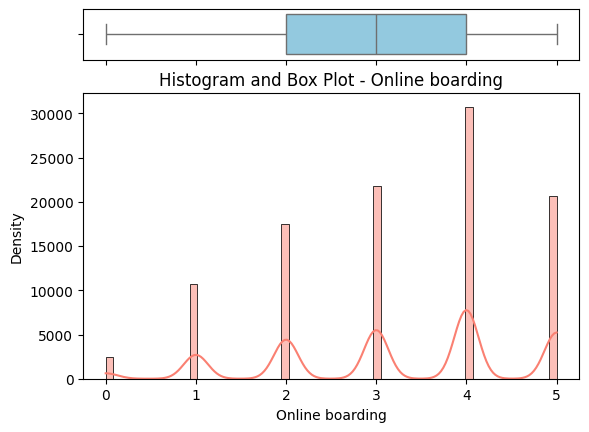


Histogram and Box Plot - Seat comfort


<Figure size 1000x600 with 0 Axes>

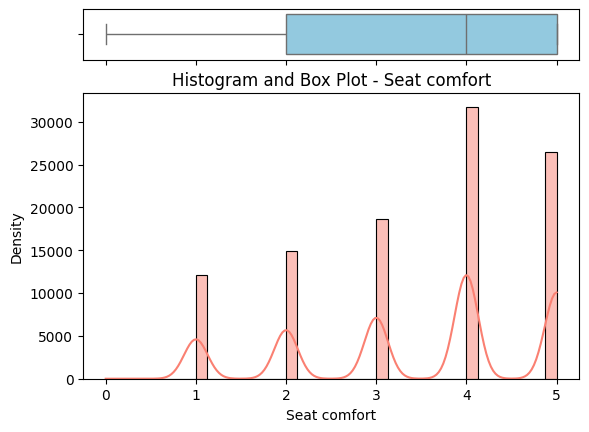


Histogram and Box Plot - Inflight entertainment


<Figure size 1000x600 with 0 Axes>

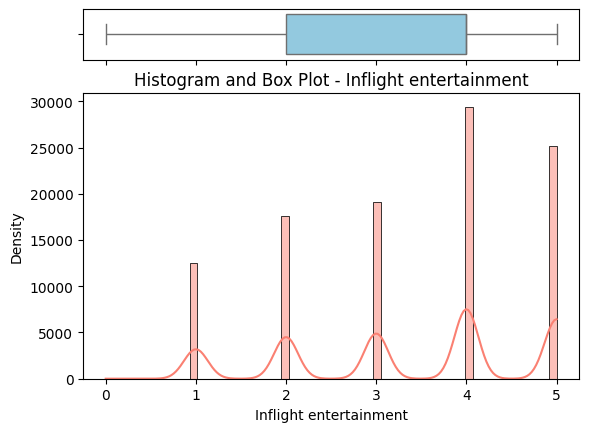


Histogram and Box Plot - On-board service


<Figure size 1000x600 with 0 Axes>

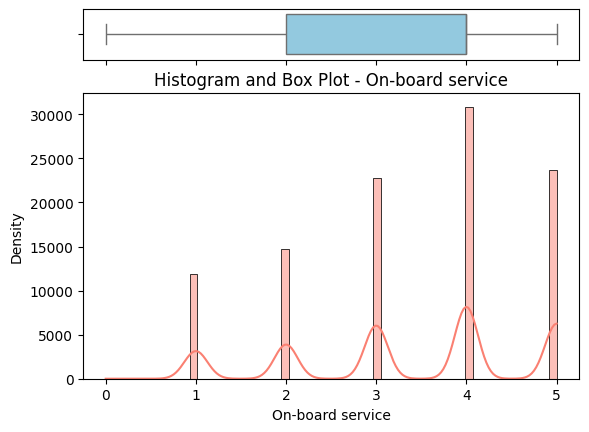


Histogram and Box Plot - Leg room service


<Figure size 1000x600 with 0 Axes>

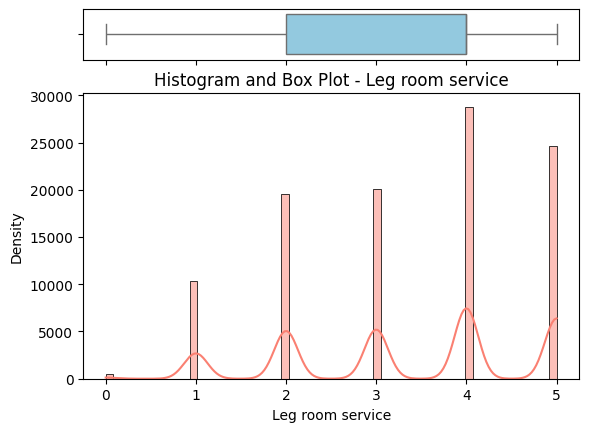


Histogram and Box Plot - Baggage handling


<Figure size 1000x600 with 0 Axes>

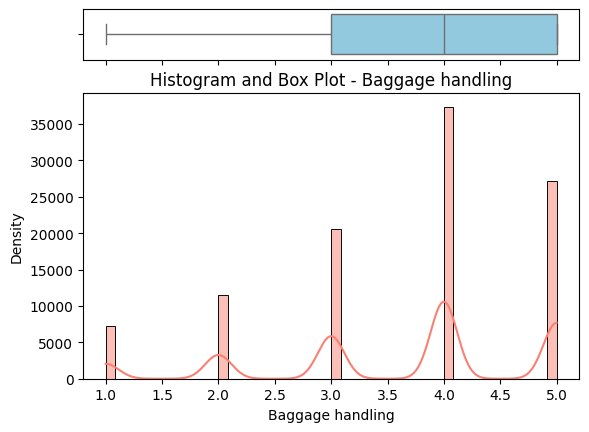


Histogram and Box Plot - Checkin service


<Figure size 1000x600 with 0 Axes>

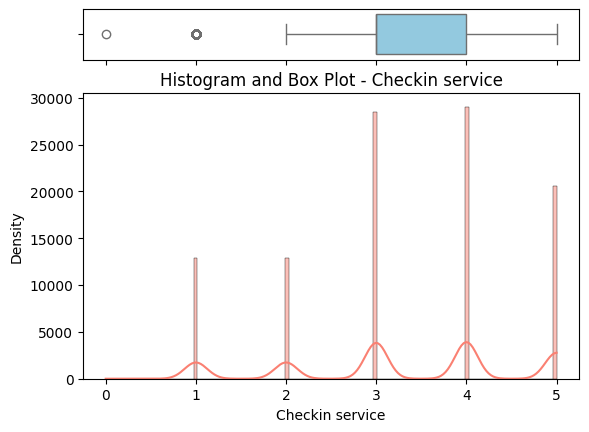


Histogram and Box Plot - Inflight service


<Figure size 1000x600 with 0 Axes>

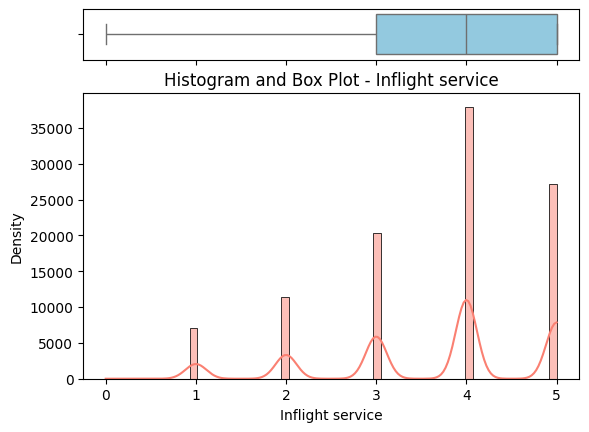


Histogram and Box Plot - Cleanliness


<Figure size 1000x600 with 0 Axes>

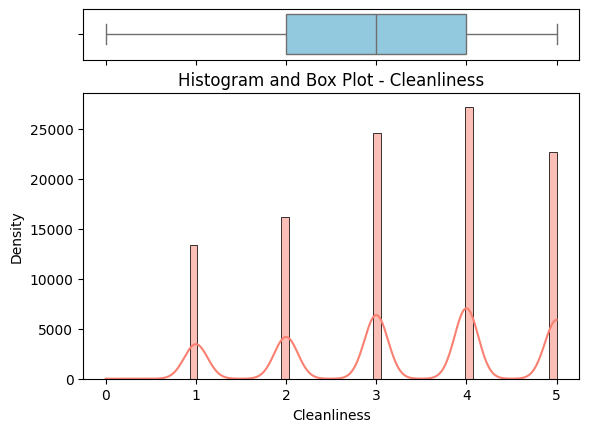


Histogram and Box Plot - Departure Delay in Minutes


<Figure size 1000x600 with 0 Axes>

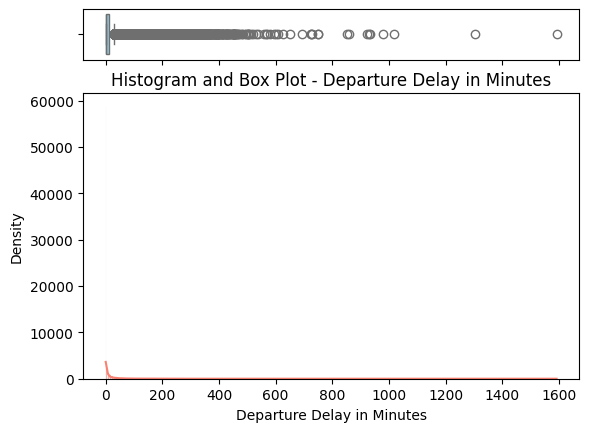


Histogram and Box Plot - Arrival Delay in Minutes


<Figure size 1000x600 with 0 Axes>

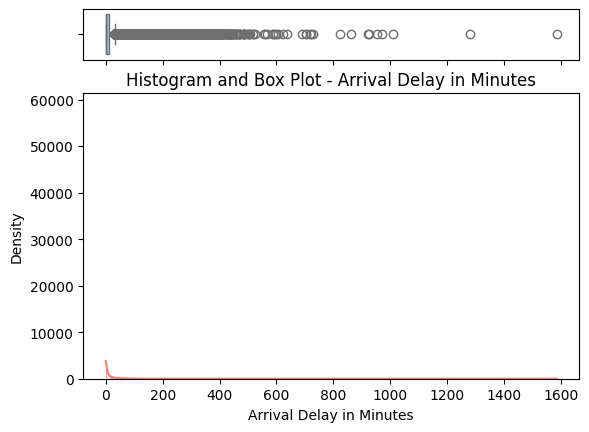

In [15]:
num_features = [
    'Age',  'Flight Distance',
    'Inflight wifi service',
    'Departure/Arrival time convenient',
    'Ease of Online booking',
    'Gate location',
    'Food and drink',
    'Online boarding',
    'Seat comfort',
    'Inflight entertainment',
    'On-board service',
    'Leg room service',
    'Baggage handling',
    'Checkin service',
    'Inflight service',
    'Cleanliness',
    'Departure Delay in Minutes',
    'Arrival Delay in Minutes'
]


for i in num_features:
    print("")
    print(f"Histogram and Box Plot - {i}")
    plt.figure(figsize=(10, 6))

    # Create subplots
    f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)})

    # Boxplot with horizontal orientation
    sns.boxplot(df[i], ax=ax_box, color='skyblue', orient='h')

    # Histogram plot
    sns.histplot(df[i], ax=ax_hist, color='salmon', kde=True)

    # Adjust the box plot
    ax_box.set(xlabel='')

    # Set titles and labels
    plt.title(f'Histogram and Box Plot - {i}')
    plt.xlabel(i)
    plt.ylabel('Density')

    # Display the plots
    plt.show()


# For Categorical features

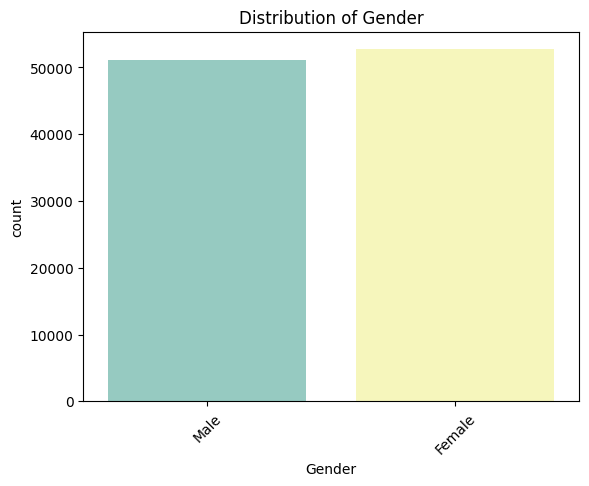

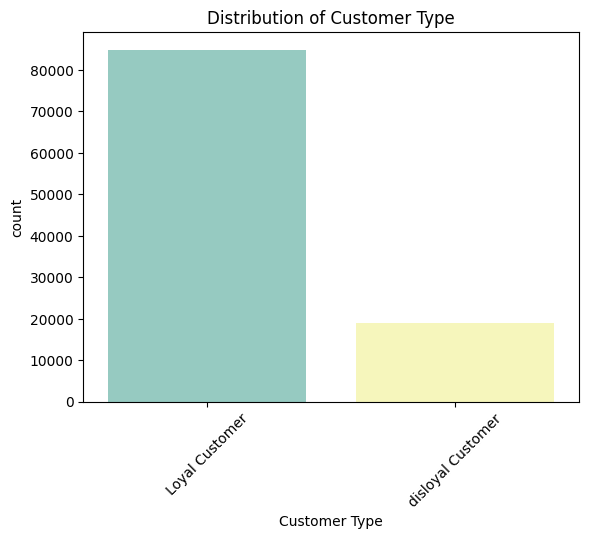

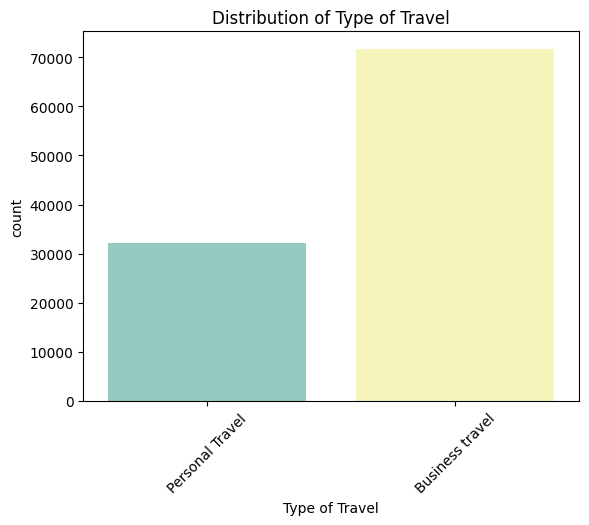

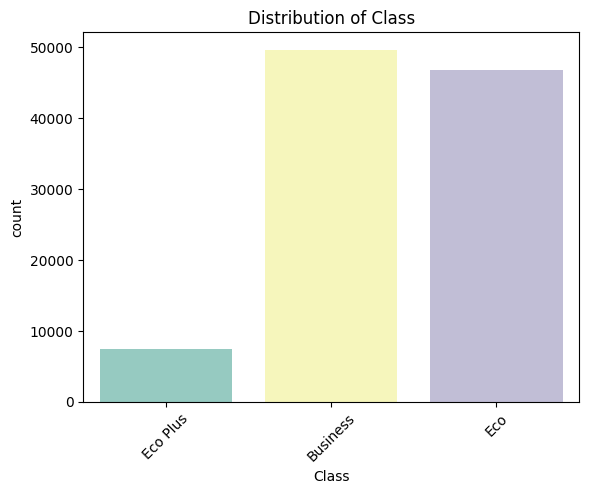

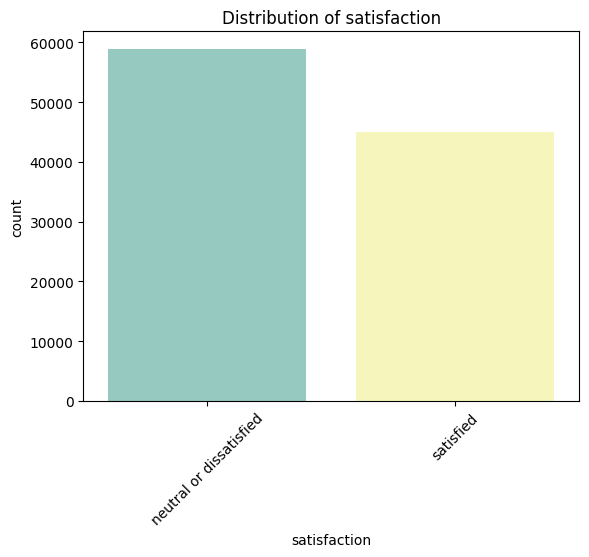

In [16]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Clean column names to remove any leading/trailing spaces
df.columns = df.columns.str.strip()

# List of features to plot
features = ['Gender', 'Customer Type', 'Type of Travel', 'Class', 'satisfaction']

# Loop through all features and create count plots
for f in features:
    sns.countplot(x=f, data=df, palette='Set3')
    plt.xticks(rotation=45)
    plt.title(f'Distribution of {f}')
    plt.show()


# Outlier removal

Shape after outlier removal: (66263, 24)


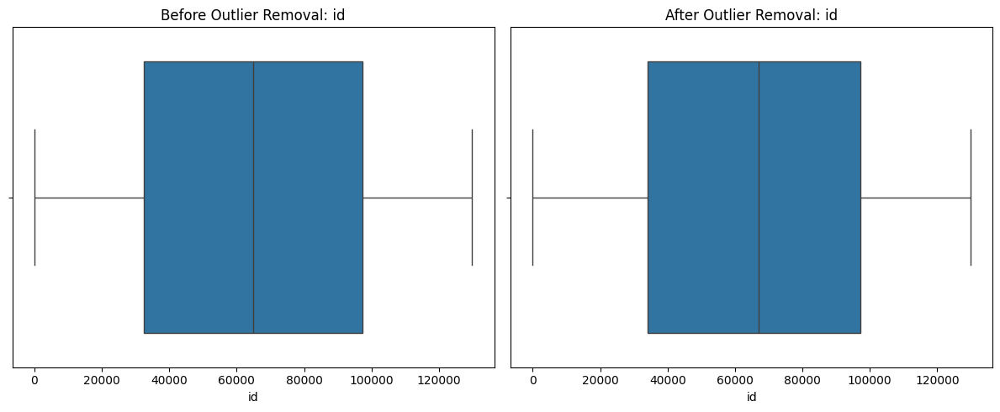

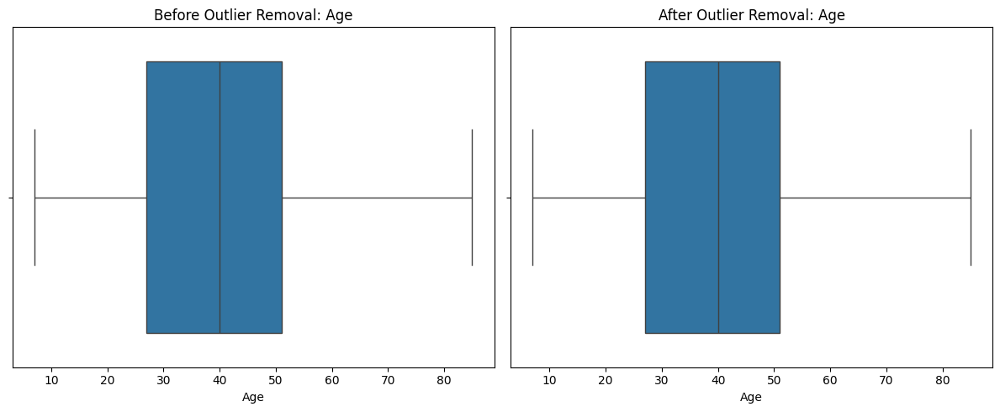

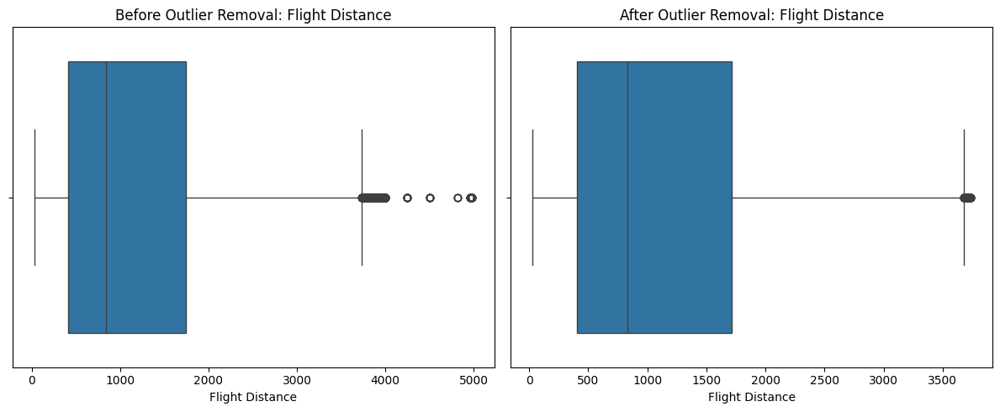

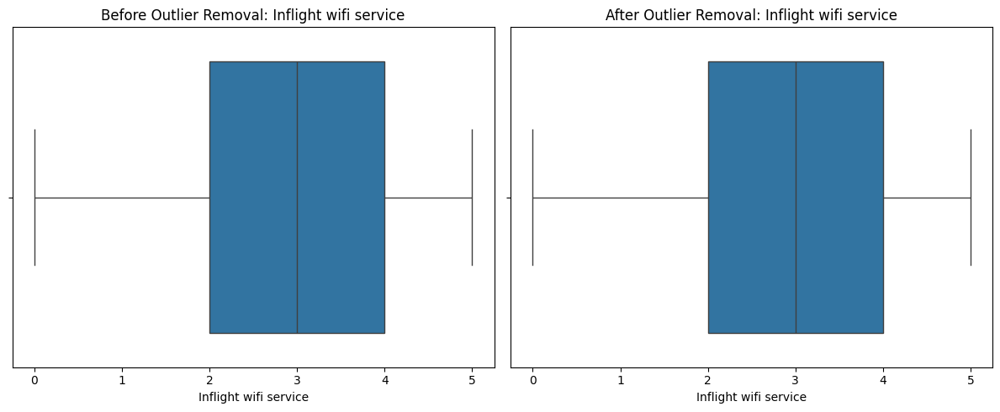

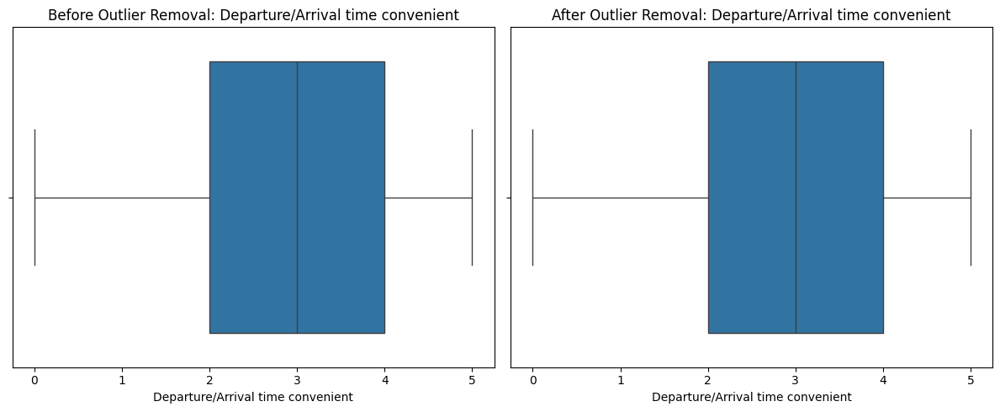

...

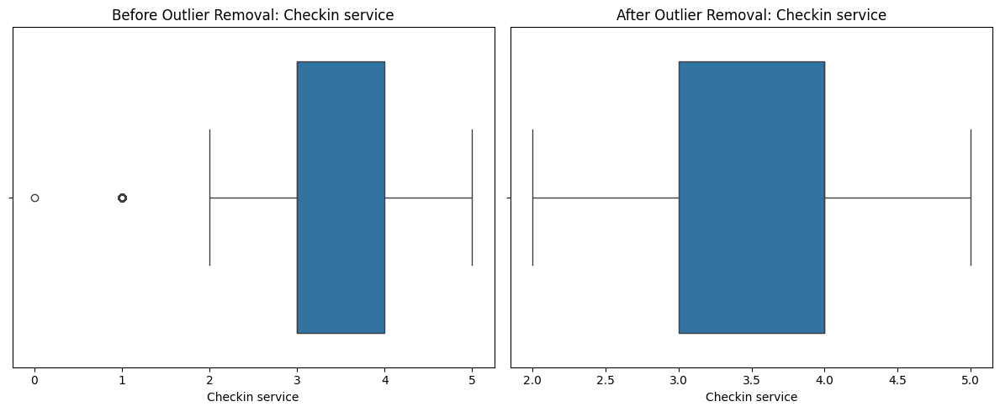

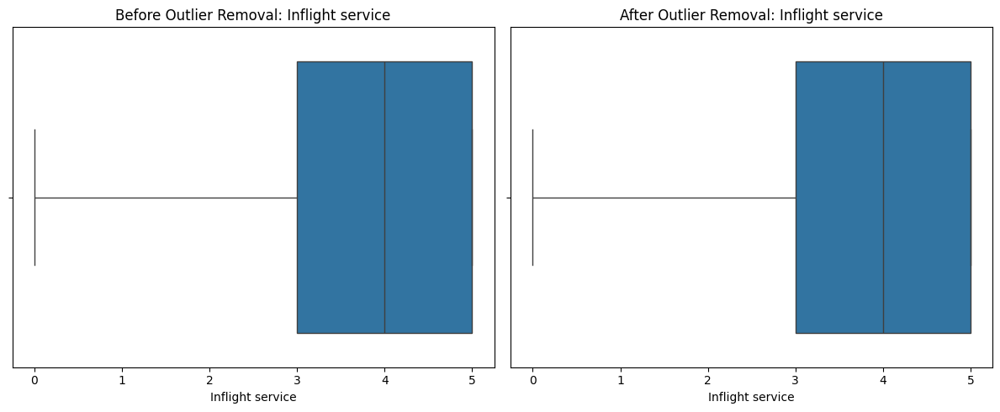

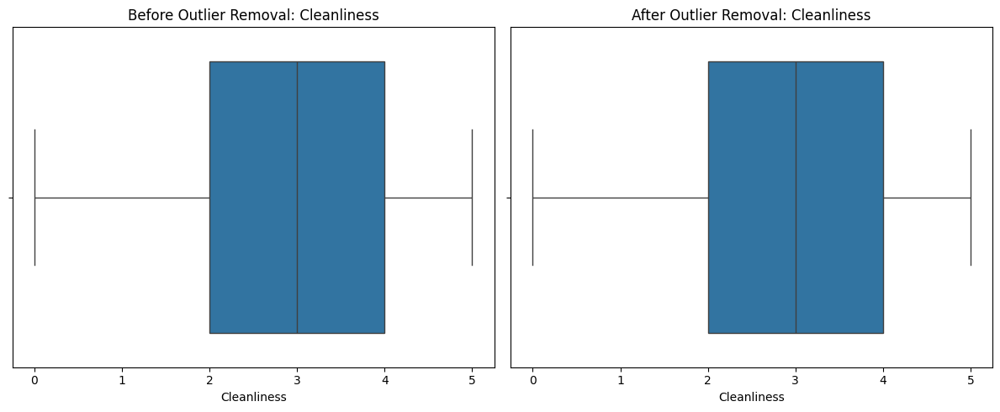

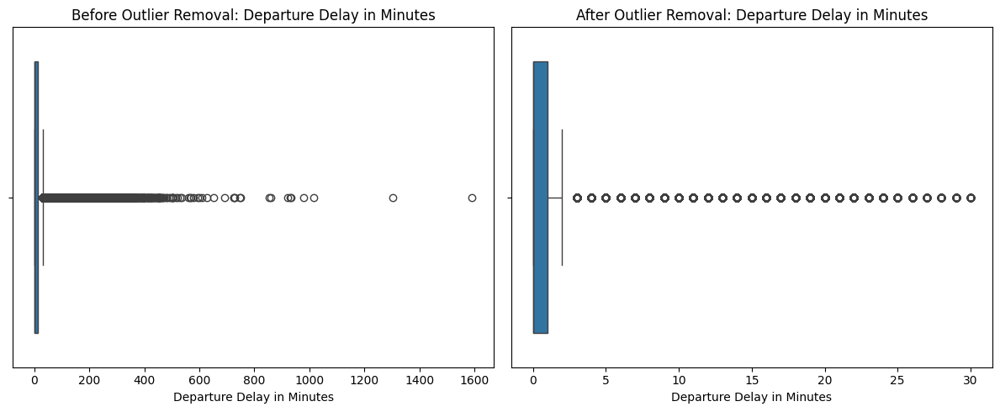

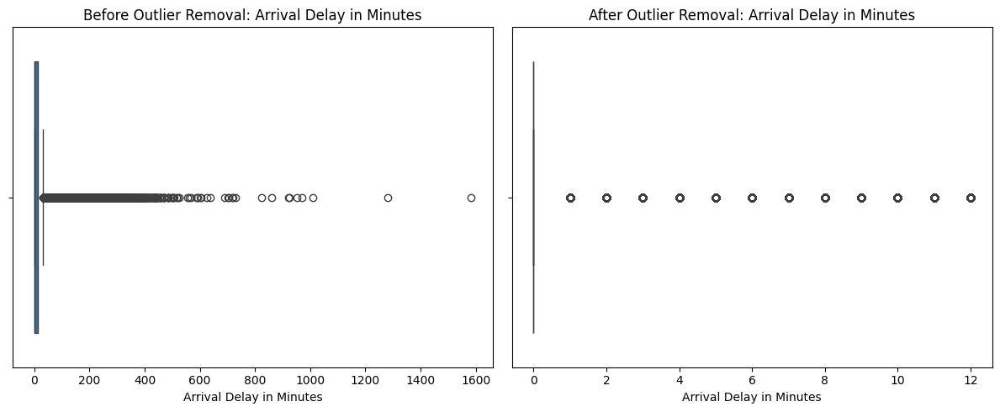

In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


# Create a copy of the original DataFrame before removing outliers
df_original = df.copy()

# Function to remove outliers based on IQR
def remove_outliers_iqr(data, column):
    Q1 = data[column].quantile(0.25)  # First quartile (25th percentile)
    Q3 = data[column].quantile(0.75)  # Third quartile (75th percentile)
    IQR = Q3 - Q1  # Interquartile range

    # Define bounds for outlier removal
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Remove outliers
    filtered_data = data[(data[column] >= lower_bound) & (data[column] <= upper_bound)]
    return filtered_data

# List of numerical columns
numerical_columns = df.select_dtypes(include=['number']).columns.tolist()

# Remove outliers for each numerical column
for column in numerical_columns:
    df = remove_outliers_iqr(df, column)

# Check the shape of the DataFrame before and after outlier removal
print("Shape after outlier removal:", df.shape)

# Function to plot boxplots for comparison
def plot_boxplots(original_df, cleaned_df, column):
    plt.figure(figsize=(12, 5))

    # Boxplot before outlier removal
    plt.subplot(1, 2, 1)
    sns.boxplot(x=original_df[column])
    plt.title(f'Before Outlier Removal: {column}')

    # Boxplot after outlier removal
    plt.subplot(1, 2, 2)
    sns.boxplot(x=cleaned_df[column])
    plt.title(f'After Outlier Removal: {column}')

    plt.tight_layout()
    plt.show()

# Plot for each numerical column
for column in numerical_columns:
    plot_boxplots(df_original, df, column)


# standardizatoin of numerical and categorical features

In [18]:
# Step 1: Identify numerical and categorical columns
numerical_columns = df.select_dtypes(include=['number']).columns.tolist()
categorical_columns = df.select_dtypes(include=['object', 'category']).columns.tolist()

# Step 2: Standardize numerical columns
scaler = StandardScaler()
df[numerical_columns] = scaler.fit_transform(df[numerical_columns])

# Step 3: One-hot encode categorical columns
df_encoded = pd.get_dummies(df, columns=categorical_columns, drop_first=True)

In [19]:
# Investigate all the elements whithin each Feature

for column in df:
    unique_vals = np.unique(df[column])
    nr_values = len(unique_vals)
    if nr_values < 10:
        print('The number of values for feature {} :{} -- {}'.format(column, nr_values,unique_vals))
    else:
        print('The number of values for feature {} :{}'.format(column, nr_values))

The number of values for feature id :66263
The number of values for feature Gender :2 -- ['Female' 'Male']
The number of values for feature Customer Type :2 -- ['Loyal Customer' 'disloyal Customer']
The number of values for feature Age :75
The number of values for feature Type of Travel :2 -- ['Business travel' 'Personal Travel']
The number of values for feature Class :3 -- ['Business' 'Eco' 'Eco Plus']
The number of values for feature Flight Distance :3474
The number of values for feature Inflight wifi service :6 -- [-2.03927975 -1.30091138 -0.56254302  0.17582534  0.9141937   1.65256206]
The number of values for feature Departure/Arrival time convenient :6 -- [-2.01447225 -1.36504938 -0.71562651 -0.06620364  0.58321924  1.23264211]
The number of values for feature Ease of Online booking :6 -- [-1.9637148  -1.25418748 -0.54466017  0.16486715  0.87439447  1.58392179]
The number of values for feature Gate location :6 -- [-2.30367822 -1.52613211 -0.748586    0.02896011  0.80650622  1.584

In [20]:
df1= df.copy() # done so if we mess up our whole data didn't mess up and later if need original data can be called directly

In [21]:
from sklearn.preprocessing import MinMaxScaler,StandardScaler, LabelEncoder

# Missing Values Treatment
def missing_value_treatment(df1):
    missing_columns=df.columns[df.isna().any()].tolist()
    numerical_cols=df.select_dtypes(include=['float64', 'int64']).columns.tolist()
    categorical_cols=list(set(df.columns) - set(numerical_cols))

    for i in missing_columns:
        if ((df[i].isna().sum() / len(df)) <= 0.05) and (len(df) > 30000):
            df[i].dropna(inplace=True)
            df.reset_index(inplace=True, drop=True)
        elif (df[i].isna().sum() / len(df)) > 0.8:
            df.drop([i], axis=1, inplace=True)
        else:
            for i in missing_columns:
                if (df[i].dtype!='int64') and (df[i].dtype!='float64'):
                    mode_val = df[i].mode()[0]
                    df[i].fillna(mode_val, inplace=True)

            label_encoders={}
            for col in categorical_cols:
                label_encoders[col]=LabelEncoder()
                df[col]=label_encoders[col].fit_transform(df[col].astype(str))

            imputer=KNNImputer(n_neighbors=5) # No hyperparameter tunning done in this version
            df_imputed=imputer.fit_transform(df)
            df_imputed=pd.DataFrame(df_imputed, columns=df.columns)

            for col in categorical_cols:
                df[col]=label_encoders[col].inverse_transform(df_imputed[col].astype(int))

            #Update numerical columns after imputation
            numerical_imputed_cols=list(set(df.columns)-set(categorical_cols))
            df[numerical_imputed_cols]=df_imputed[numerical_imputed_cols]

    print("Dataset is treated for missing values successfully")

# Duplicate Values Treatment
def duplicate_value_treatment(df1):
    df.drop_duplicates(inplace=True)
    df.reset_index(drop=True,inplace=True)
    print("Dataset is treated for duplicated values successfully")

# Standardization of Numerical Columns
def data_standardization(df1,type):
    num_var=[]
    for i in df.drop([taget ],axis=1).columns:
        if (df[i].dtype!='object') and (df[i].dtype.name!='category'):
            num_var.append(i)
    if type==1:
        scaler=StandardScaler()
        for i in num_var:
            df[i]=scaler.fit_transform(df[[i]]).round(2)
    elif type==2:
        scaler = MinMaxScaler()
        for i in num_var:
            df[i]=scaler.fit_transform(df[[i]]).round(2)

# Categorical Encoding
def cat_encoding(df1):
    cat_var=[]
    for i in df.drop([taget ],axis=1).columns:
        if (df[i].dtype=='object') or (df[i].dtype.name=='category'):
            cat_var.append(i)
    label_encoder = LabelEncoder()
    for feature in cat_var:
        df[feature] = label_encoder.fit_transform(df[feature])


In [22]:
df1.columns

Index(['id', 'Gender', 'Customer Type', 'Age', 'Type of Travel', 'Class',
       'Flight Distance', 'Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes',
       'satisfaction'],
      dtype='object')

In [23]:
df1.describe()

,id,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
count,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04,6.626300e+04
mean,1.441181e-16,-1.207418e-16,4.878996e-17,1.155947e-16,1.758449e-16,6.728726e-18,-1.516242e-16,-1.286768e-17,-1.027270e-16,-1.540905e-16,1.396680e-16,-3.109690e-17,1.993419e-16,2.019154e-16,-1.961249e-16,6.155042e-17,-1.267467e-16,-1.935514e-17,-1.860453e-17
std,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00,1.000008e+00
min,-1.774642e+00,-2.153181e+00,-1.198705e+00,-2.039280e+00,-2.014472e+00,-1.963715e+00,-2.303678e+00,-2.458238e+00,-2.453108e+00,-1.903672e+00,-2.568764e+00,-2.763886e+00,-2.611442e+00,-2.318711e+00,-1.673669e+00,-3.228618e+00,-2.578724e+00,-4.489314e-01,-4.652617e-01
25%,-8.594673e-01,-8.291268e-01,-7.951195e-01,-5.625430e-01,-7.156265e-01,-5.446602e-01,-7.485860e-01,-9.429379e-01,-9.784548e-01,-3.835470e-01,-1.063518e+00,-3.850916e-01,-1.076409e+00,-6.118886e-01,-6.565990e-01,-6.396780e-01,-1.038743e+00,-4.489314e-01,-4.652617e-01
50%,2.360019e-02,3.150830e-02,-3.367928e-01,1.758253e-01,-6.620364e-02,1.648672e-01,2.896011e-02,-1.852877e-01,4.961986e-01,3.765157e-01,4.417287e-01,4.078398e-01,4.586242e-01,2.415228e-01,3.604710e-01,2.233019e-01,-2.687524e-01,-4.489314e-01,-4.652617e-01
75%,8.362066e-01,7.597380e-01,6.088413e-01,9.141937e-01,5.832192e-01,8.743945e-01,8.065062e-01,5.723624e-01,4.961986e-01,1.136578e+00,1.194352e+00,4.078398e-01,4.586242e-01,1.094934e+00,3.604710e-01,1.086282e+00,5.012382e-01,-2.458113e-01,-4.652617e-01
max,1.714935e+00,3.010630e+00,2.778111e+00,1.652562e+00,1.232642e+00,1.583922e+00,1.584052e+00,1.330013e+00,1.233525e+00,1.136578e+00,1.194352e+00,1.200771e+00,1.226141e+00,1.094934e+00,1.377541e+00,1.086282e+00,1.271229e+00,5.644670e+00,3.615701e+00


### to understand distribution for numerical values


In [24]:
# Standardization of Numerical Columns
def data_standardization(df1, type):
    num_var = []

    # Collect numerical variables
    for i in df1.drop(['satisfaction'], axis=1).columns:
        if (df1[i].dtype != 'object') and (df1[i].dtype.name != 'category'):
            num_var.append(i)

    if type == 1:
        scaler = StandardScaler()
        for i in num_var:
            df1[i] = scaler.fit_transform(df1[[i]]).round(2)
    elif type == 2:
        scaler = MinMaxScaler()
        for i in num_var:
            df1[i] = scaler.fit_transform(df1[[i]]).round(2)

    return df1  # Return the modified DataFrame

# Categorical Encoding
def cat_encoding(df1):
    cat_var = []

    # Collect categorical variables
    for i in df1.drop(['satisfaction'], axis=1).columns:
        if (df1[i].dtype == 'object') or (df1[i].dtype.name == 'category'):
            cat_var.append(i)

    label_encoder = LabelEncoder()
    for feature in cat_var:
        df1[feature] = label_encoder.fit_transform(df1[feature])

    return df1  # Return the modified DataFrame

# Apply the functions and reassign df1
df1 = cat_encoding(df1)
df1 = data_standardization(df1, 2)

# Check the first few rows of df1 to ensure changes are applied
print(df1.head())


     id  Gender  Customer Type   Age  Type of Travel  Class  Flight Distance  \
2  0.85     0.0            0.0  0.24             0.0    0.0             0.30   
4  0.92     1.0            0.0  0.69             0.0    0.0             0.05   
5  0.86     0.0            0.0  0.24             1.0    0.5             0.31   
7  0.74     0.0            0.0  0.58             0.0    0.0             0.54   
8  0.61     0.0            0.0  0.44             0.0    0.0             0.22   

   Inflight wifi service  Departure/Arrival time convenient  \
2                    0.4                                0.4   
4                    0.6                                0.6   
5                    0.6                                0.8   
7                    0.8                                0.6   
8                    0.2                                0.4   

   Ease of Online booking  ...  Inflight entertainment  On-board service  \
2                     0.4  ...                     1.0          

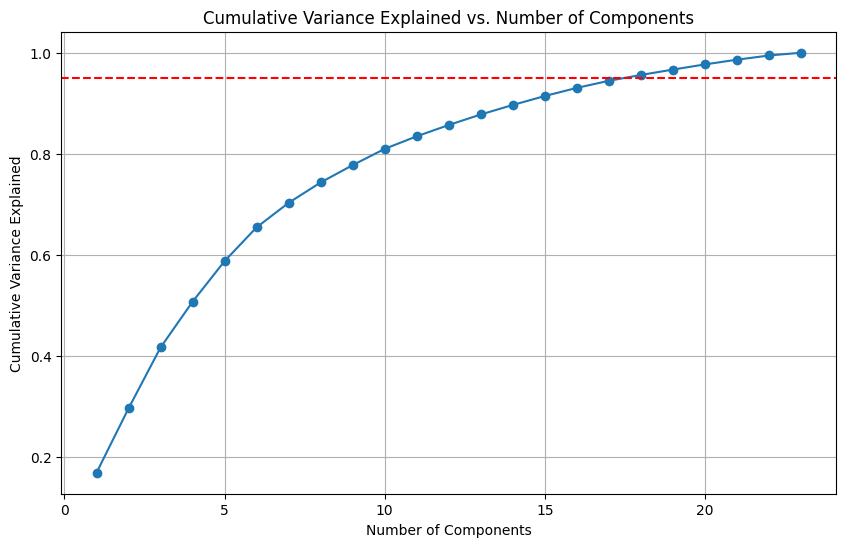

In [31]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder

def pca_selection(df1, target, num_components=None):
    # Ensure all categorical columns are encoded
    cat_var = []
    for i in df1.columns:
        if df1[i].dtype == 'object' or df1[i].dtype.name == 'category':
            cat_var.append(i)

    # Label encode categorical columns
    if len(cat_var) > 0:
        label_encoder = LabelEncoder()
        for feature in cat_var:
            df1[feature] = label_encoder.fit_transform(df1[feature])

    # Fit PCA
    pca = PCA(random_state=123)
    pca.fit(df1.drop([target], axis=1))

    # Calculate cumulative variance
    cumulative_variance = np.cumsum(pca.explained_variance_ratio_)

    # Plot cumulative variance explained vs. number of components
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', linestyle='-')
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Variance Explained')
    plt.title('Cumulative Variance Explained vs. Number of Components')
    plt.grid(True)
    plt.axhline(y=0.95, color='r', linestyle='--')  # Line for 95% variance threshold
    plt.show()

    # If num_components is not provided, set a default value
    if num_components is None:
        num_components = int(input("Enter the number of components for PCA: "))

    # Fit PCA with selected number of components
    pca = PCA(n_components=num_components)
    pca_df = pca.fit_transform(df1.drop([target], axis=1))

    # Create a DataFrame for PCA results
    pca_df = pd.DataFrame(pca_df, columns=[f'PC{i+1}' for i in range(num_components)])
    pca_df[target] = df1[target].values  # Retain the target variable

    return pca_df

# Call the function with a predefined number of components (optional)
pca_results = pca_selection(df1, 'satisfaction', num_components=2)  # Change 2 to the desired number of components


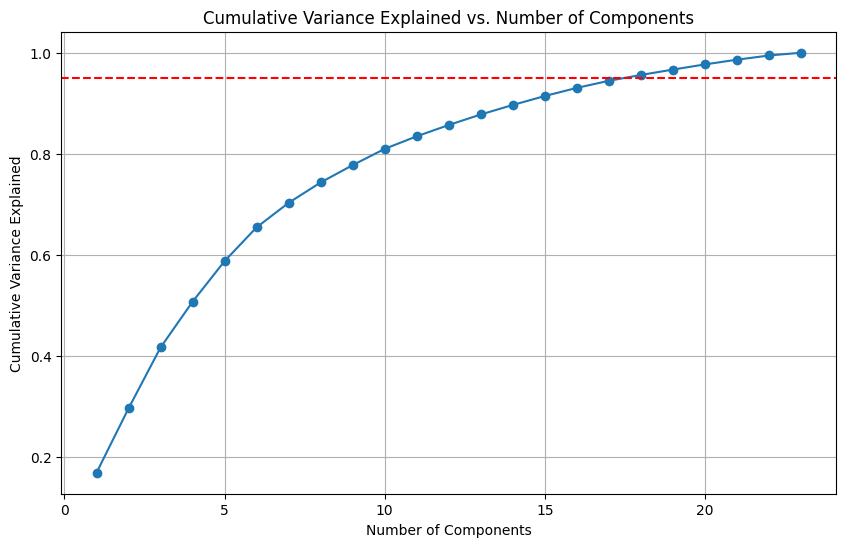

In [32]:
# Call the function with a predefined number of components (optional)
pca_results = pca_selection(df1, 'satisfaction', num_components=15)

In [35]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns  # Make sure to import seaborn
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder

# Function to perform PCA
def pca_selection(df1, target, num_components=None):
    # Ensure all categorical columns are encoded
    cat_var = []
    for i in df1.columns:
        if df1[i].dtype == 'object' or df1[i].dtype.name == 'category':
            cat_var.append(i)

    # Label encode categorical columns
    if len(cat_var) > 0:
        label_encoder = LabelEncoder()
        for feature in cat_var:
            df1[feature] = label_encoder.fit_transform(df1[feature])

    # Fit PCA
    pca = PCA(random_state=123)
    pca.fit(df1.drop([target], axis=1))

    # Calculate cumulative variance
    cumulative_variance = np.cumsum(pca.explained_variance_ratio_)

    # Plot cumulative variance explained vs. number of components
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', linestyle='-')
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Variance Explained')
    plt.title('Cumulative Variance Explained vs. Number of Components')
    plt.grid(True)
    plt.axhline(y=0.95, color='r', linestyle='--')  # Line for 95% variance threshold
    plt.show()

    # If num_components is not provided, set a default value
    if num_components is None:
        num_components = int(input("Enter the number of components for PCA: "))

    # Fit PCA with selected number of components
    pca = PCA(n_components=num_components)
    pca_df = pca.fit_transform(df1.drop([target], axis=1))

    # Create a DataFrame for PCA results
    pca_df = pd.DataFrame(pca_df, columns=[f'PC{i+1}' for i in range(num_components)])
    pca_df[target] = df1[target].values  # Retain the target variable

    return pca_df

# Function to visualize PCA
def visualize_pca(pca_df):
    # Select the first two principal components for 2D visualization
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='PC1', y='PC2', data=pca_df, color='blue', s=50)

    # Customize the plot
    plt.title('PCA Visualization (First 2 Principal Components)')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.grid(True)
    plt.show()



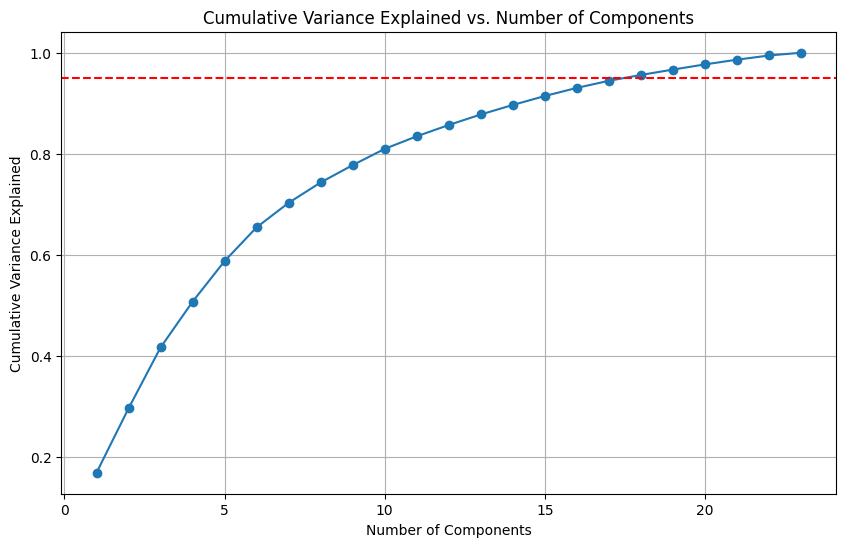

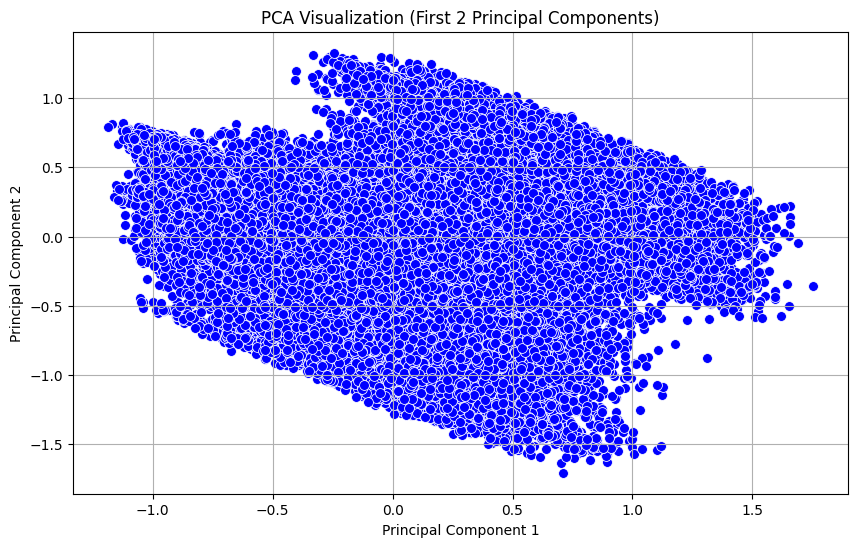

In [36]:
# Example usage
pca_df = pca_selection(df1, 'satisfaction', num_components=15)  # Change num_components as needed
visualize_pca(pca_df)


## looking at the PCA above it can be interpreted that some clusters are present. further clarification need more processing

Non-numeric columns: Index([], dtype='object')


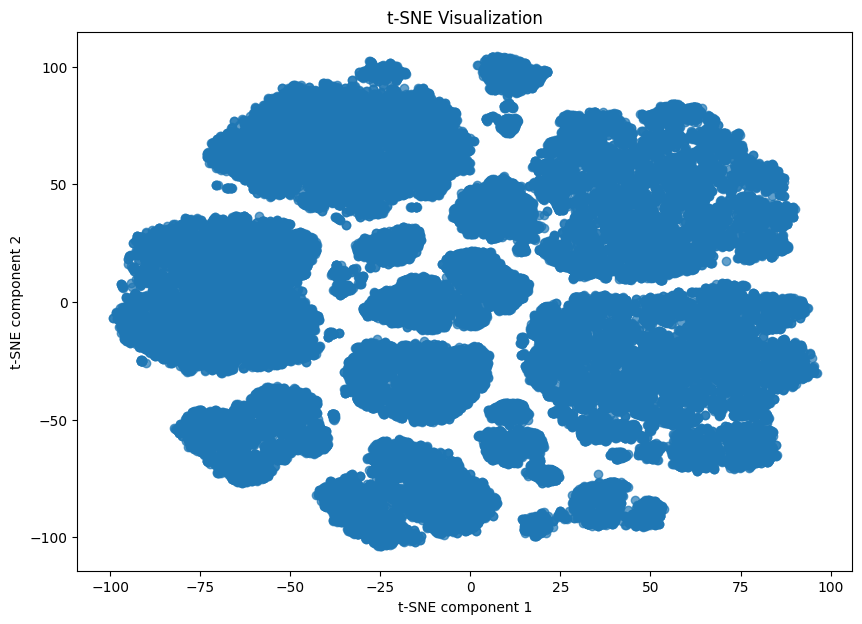

In [37]:
import pandas as pd
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

df2 =df1.copy()

# Check if there are non-numeric columns
non_numeric_columns = df2.select_dtypes(include=['object']).columns
print(f"Non-numeric columns: {non_numeric_columns}")

# Drop non-numeric columns or encode them if needed (here, we drop them)
df2_numeric = df2.drop(columns=non_numeric_columns)

# Apply t-SNE
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000)
df_tsne = tsne.fit_transform(df2_numeric)

# Plot the t-SNE results
plt.figure(figsize=(10, 7))
plt.scatter(df_tsne[:, 0], df_tsne[:, 1], cmap='viridis', alpha=0.7)
plt.title('t-SNE Visualization')
plt.xlabel('t-SNE component 1')
plt.ylabel('t-SNE component 2')
plt.show()


# Elbow method to find the Optimal number of Clusters


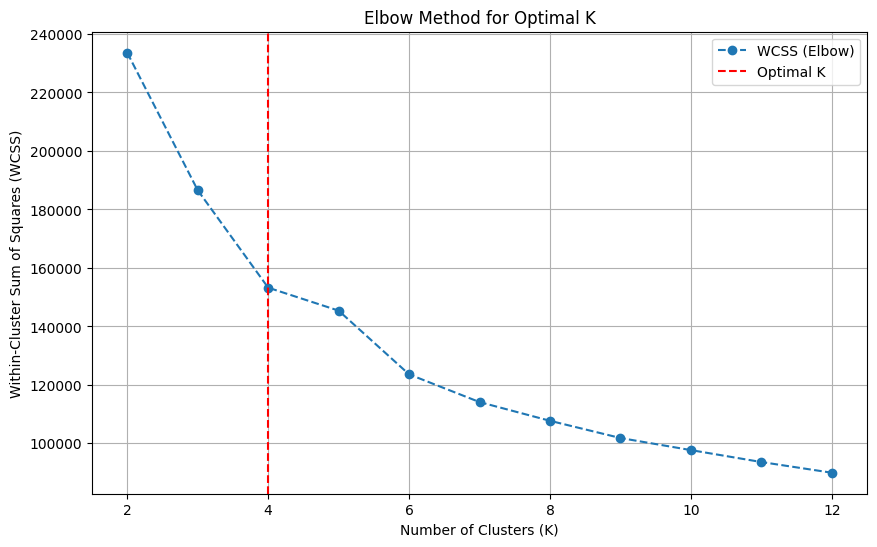

Optimal number of clusters: 4


In [45]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Assuming df2 is your DataFrame

# Step 1: One-hot encode categorical columns
df2_encoded = pd.get_dummies(df2, columns=['Gender', 'Customer Type', 'Type of Travel'], drop_first=True)

# Step 2: Standardize continuous columns
continuous_columns = ['Age', 'Flight Distance', 'Departure Delay in Minutes', 'Arrival Delay in Minutes']
scaler = StandardScaler()
df2_encoded[continuous_columns] = scaler.fit_transform(df2_encoded[continuous_columns])

# Step 3: Automatically collect the new one-hot encoded feature names
categorical_columns = ['Gender', 'Customer Type', 'Type of Travel']
one_hot_encoded_columns = [col for col in df2_encoded.columns if any(cat in col for cat in categorical_columns)]

# Step 4: Combine continuous and one-hot encoded features
features_cluster = continuous_columns + one_hot_encoded_columns

# Elbow method: Calculate WCSS (Within-Cluster Sum of Squares)
def elbow_method(data, max_clusters=12):
    wcss = []
    cluster_list = list(np.arange(2, max_clusters + 1))

    for n_clusters in cluster_list:
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        kmeans.fit(data)
        wcss.append(kmeans.inertia_)

    return wcss, cluster_list

# Step 5: Compute elbow values
wcss, cluster_list = elbow_method(df2_encoded[features_cluster], max_clusters=12)

# Step 6: Find the optimal number of clusters
diff = np.diff(wcss)  # First derivative
second_diff = np.diff(diff)  # Second derivative

# Finding the elbow point
optimal_k = np.argmin(second_diff) + 2  # Add 2 because diff reduces length by 1

# Step 7: Plotting Elbow Method
plt.figure(figsize=(10, 6))
plt.plot(cluster_list, wcss, marker='o', linestyle='--', label='WCSS (Elbow)')
plt.axvline(x=optimal_k, color='red', linestyle='--', label='Optimal K')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
plt.title('Elbow Method for Optimal K')
plt.legend()
plt.grid(True)
plt.show()

# Print optimal number of clusters
print(f'Optimal number of clusters: {optimal_k}')


## 1. K-Means (Euclidean)


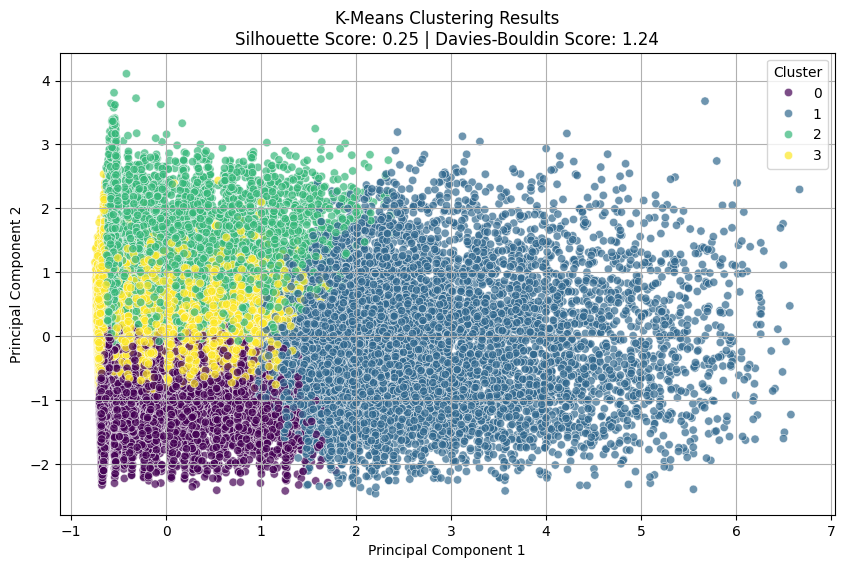

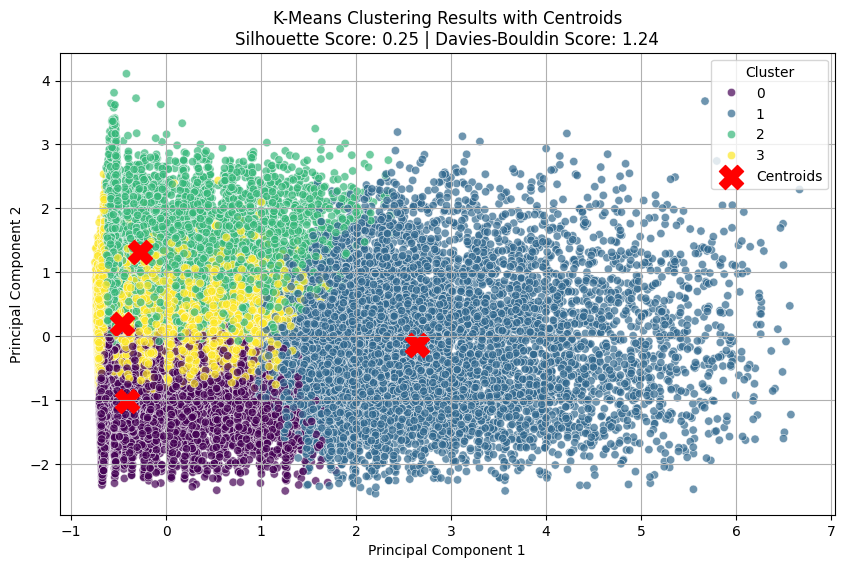

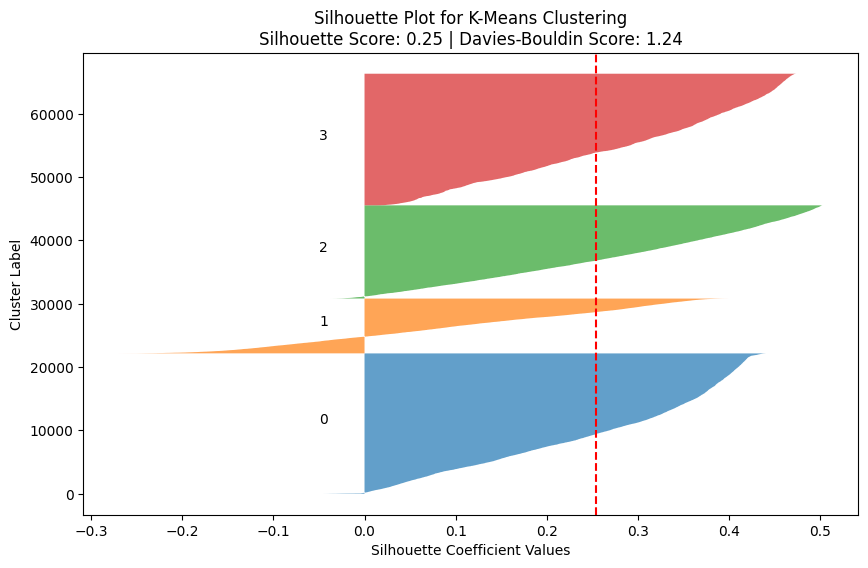

In [46]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_samples, davies_bouldin_score, silhouette_score
from sklearn.cluster import KMeans

# Assuming df2_encoded and features_cluster are already defined

# Step 1: Use the full dataset
# df_sample = df2_encoded.sample(frac=0.25, random_state=42)  # Remove this line

# Step 2: Fix number of clusters (k)
optimal_k = 4  # Replace with your determined optimal K

# Fit K-Means
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
kmeans_labels = kmeans.fit_predict(df2_encoded[features_cluster])  # Use full data here

# Step 3: Reduce dimensions using PCA
pca = PCA(n_components=2, random_state=42)
reduced_data = pca.fit_transform(df2_encoded[features_cluster])  # Use full data here

# Step 4: Create a DataFrame with PCA results and cluster labels
pca_df = pd.DataFrame(reduced_data, columns=['PC1', 'PC2'])
pca_df['Cluster'] = kmeans_labels

# Calculate performance metrics
kmeans_silhouette = silhouette_score(df2_encoded[features_cluster], kmeans_labels)  # Use full data here
kmeans_davies_bouldin = davies_bouldin_score(df2_encoded[features_cluster], kmeans_labels)  # Use full data here

# Step 5: Scatter Plot of Clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Cluster', palette='viridis', alpha=0.7)
plt.title(f'K-Means Clustering Results\nSilhouette Score: {kmeans_silhouette:.2f} | Davies-Bouldin Score: {kmeans_davies_bouldin:.2f}')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

# Step 6: Plot the centroids
centroids = pca.transform(kmeans.cluster_centers_)
plt.figure(figsize=(10, 6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Cluster', palette='viridis', alpha=0.7)
plt.scatter(centroids[:, 0], centroids[:, 1], s=300, c='red', marker='X', label='Centroids')
plt.title(f'K-Means Clustering Results with Centroids\nSilhouette Score: {kmeans_silhouette:.2f} | Davies-Bouldin Score: {kmeans_davies_bouldin:.2f}')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

# Step 7: Silhouette Plot
silhouette_vals = silhouette_samples(df2_encoded[features_cluster], kmeans_labels)  # Use full data here
y_lower = 10  # Starting point for the silhouette plot

plt.figure(figsize=(10, 6))
for i in range(optimal_k):
    # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
    ith_cluster_silhouette_values = silhouette_vals[kmeans_labels == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i  # The y limit for the cluster
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, alpha=0.7)
    # Label the silhouette plots with their cluster number at the middle
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    # Update the next y_lower for the next cluster
    y_lower = y_upper + 10  # Add 10 for spacing between clusters

plt.axvline(x=kmeans_silhouette, color='red', linestyle='--')
plt.title(f"Silhouette Plot for K-Means Clustering\nSilhouette Score: {kmeans_silhouette:.2f} | Davies-Bouldin Score: {kmeans_davies_bouldin:.2f}")
plt.xlabel("Silhouette Coefficient Values")
plt.ylabel("Cluster Label")
plt.show()


## 2.  K-Prototypes

K-Prototypes Silhouette Score: 0.27
K-Prototypes Davies-Bouldin Score: 1.35


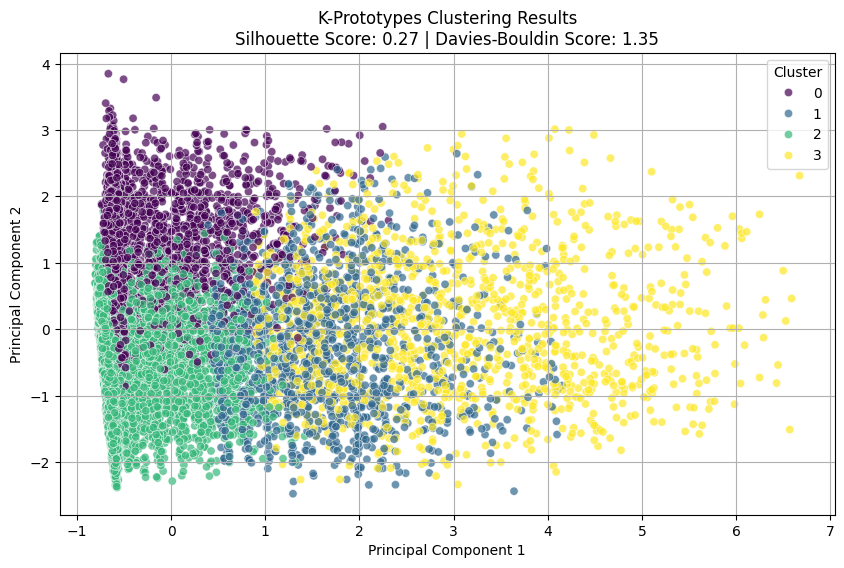

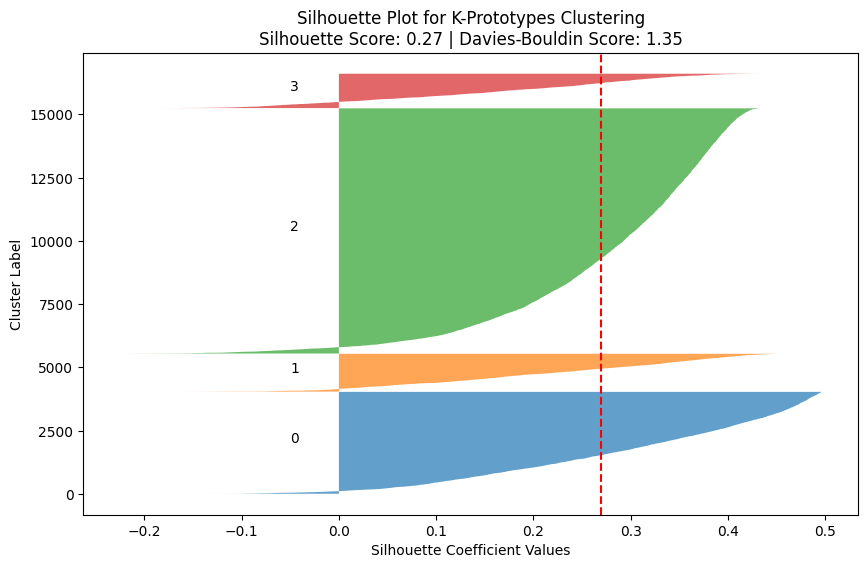

In [50]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_samples, davies_bouldin_score, silhouette_score
from kmodes.kprototypes import KPrototypes

# Assuming df2_encoded and features_cluster are already defined

# Step 1: Use 25% of the dataset randomly
df_sample = df2_encoded.sample(frac=0.25, random_state=42)  # Randomly sample 25%

# Step 2: Fix number of clusters (k)
optimal_k = 4  # Replace with your determined optimal K

# Fit K-Prototypes
# Adjust the categorical indices according to your dataset's structure
categorical_indices = [1, 2, 4, 5]  # Adjust based on your categorical feature indices
kproto = KPrototypes(n_clusters=optimal_k, random_state=42)
kproto_labels = kproto.fit_predict(df_sample, categorical=categorical_indices)

# Calculate performance metrics
kproto_silhouette = silhouette_score(df_sample[features_cluster], kproto_labels)
kproto_davies_bouldin = davies_bouldin_score(df_sample[features_cluster], kproto_labels)

# Print the performance metrics
print(f"K-Prototypes Silhouette Score: {kproto_silhouette:.2f}")
print(f"K-Prototypes Davies-Bouldin Score: {kproto_davies_bouldin:.2f}")

# Step 3: Reduce dimensions using PCA
pca = PCA(n_components=2, random_state=42)
reduced_data = pca.fit_transform(df_sample)

# Step 4: Create a DataFrame with PCA results and cluster labels
pca_df = pd.DataFrame(reduced_data, columns=['PC1', 'PC2'])
pca_df['Cluster'] = kproto_labels

# Step 5: Scatter Plot of Clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Cluster', palette='viridis', alpha=0.7)
plt.title(f'K-Prototypes Clustering Results\nSilhouette Score: {kproto_silhouette:.2f} | Davies-Bouldin Score: {kproto_davies_bouldin:.2f}')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

# Step 6: Silhouette Plot
silhouette_vals = silhouette_samples(df_sample[features_cluster], kproto_labels)
y_lower = 10  # Starting point for the silhouette plot

plt.figure(figsize=(10, 6))
for i in range(optimal_k):
    # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
    ith_cluster_silhouette_values = silhouette_vals[kproto_labels == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i  # The y limit for the cluster
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, alpha=0.7)
    # Label the silhouette plots with their cluster number at the middle
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    # Update the next y_lower for the next cluster
    y_lower = y_upper + 10  # Add 10 for spacing between clusters

plt.axvline(x=kproto_silhouette, color='red', linestyle='--')
plt.title(f"Silhouette Plot for K-Prototypes Clustering\nSilhouette Score: {kproto_silhouette:.2f} | Davies-Bouldin Score: {kproto_davies_bouldin:.2f}")
plt.xlabel("Silhouette Coefficient Values")
plt.ylabel("Cluster Label")
plt.show()


## 3. Gower Distance


In [53]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_samples, davies_bouldin_score, silhouette_score
import gower
from sklearn.cluster import AgglomerativeClustering

# Assuming df2_encoded and features_cluster are already defined

# Step 1: Use 25% of the dataset randomly
df_sample = df2_encoded.sample(frac=0.25, random_state=42)  # Randomly sample 25%

# Step 2: Fix number of clusters (k)
optimal_k = 4  # Replace with your determined optimal K

# Step 3: Calculate Gower distance matrix
gower_distance = gower.gower_matrix(df_sample)

# Step 4: Fit Agglomerative Clustering with Gower distance
agg_clustering = AgglomerativeClustering(n_clusters=optimal_k, affinity='precomputed', linkage='average')
agg_labels = agg_clustering.fit_predict(gower_distance)

# Calculate performance metrics
agg_silhouette = silhouette_score(gower_distance, agg_labels, metric='precomputed')
agg_davies_bouldin = davies_bouldin_score(df_sample[features_cluster], agg_labels)

# Print the performance metrics
print(f"Agglomerative Clustering Silhouette Score: {agg_silhouette:.2f}")
print(f"Agglomerative Clustering Davies-Bouldin Score: {agg_davies_bouldin:.2f}")

# Step 5: Reduce dimensions using PCA for visualization
# Note: Use the original sampled data for PCA
pca = PCA(n_components=2, random_state=42)
reduced_data = pca.fit_transform(df_sample)

# Step 6: Create a DataFrame with PCA results and cluster labels
pca_df = pd.DataFrame(reduced_data, columns=['PC1', 'PC2'])
pca_df['Cluster'] = agg_labels

# Step 7: Scatter Plot of Clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Cluster', palette='viridis', alpha=0.7)
plt.title(f'Agglomerative Clustering Results\nSilhouette Score: {agg_silhouette:.2f} | Davies-Bouldin Score: {agg_davies_bouldin:.2f}')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

# Step 8: Silhouette Plot
silhouette_vals = silhouette_samples(gower_distance, agg_labels, metric='precomputed')
y_lower = 10  # Starting point for the silhouette plot

plt.figure(figsize=(10, 6))
for i in range(optimal_k):
    # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
    ith_cluster_silhouette_values = silhouette_vals[agg_labels == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i  # The y limit for the cluster
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, alpha=0.7)
    # Label the silhouette plots with their cluster number at the middle
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    # Update the next y_lower for the next cluster
    y_lower = y_upper + 10  # Add 10 for spacing between clusters

plt.axvline(x=agg_silhouette, color='red', linestyle='--')
plt.title(f"Silhouette Plot for Agglomerative Clustering\nSilhouette Score: {agg_silhouette:.2f} | Davies-Bouldin Score: {agg_davies_bouldin:.2f}")
plt.xlabel("Silhouette Coefficient Values")
plt.ylabel("Cluster Label")
plt.show()


TypeError: AgglomerativeClustering.__init__() got an unexpected keyword argument 'affinity'

## 4. KMedoids


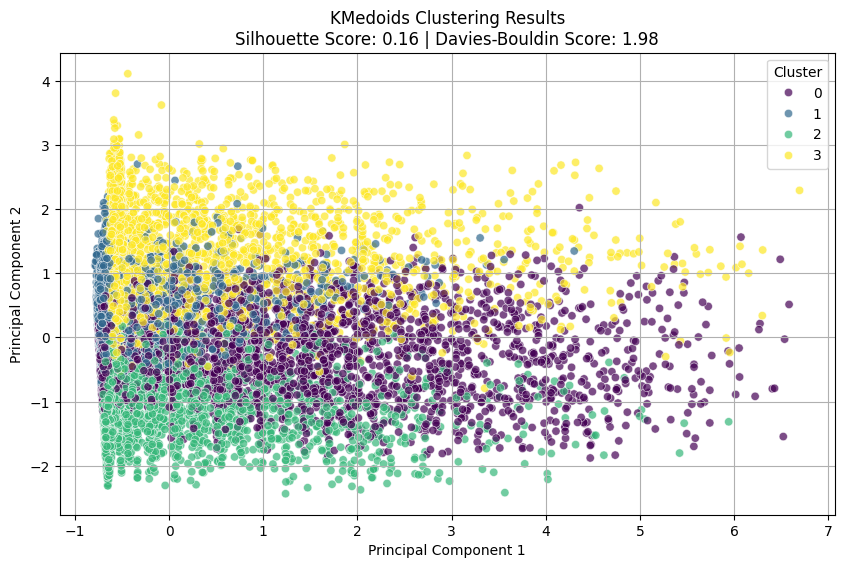

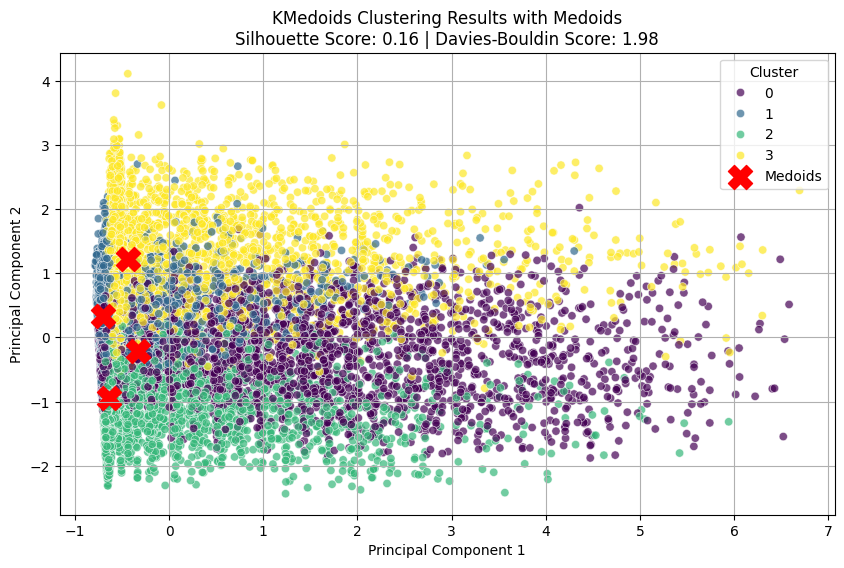

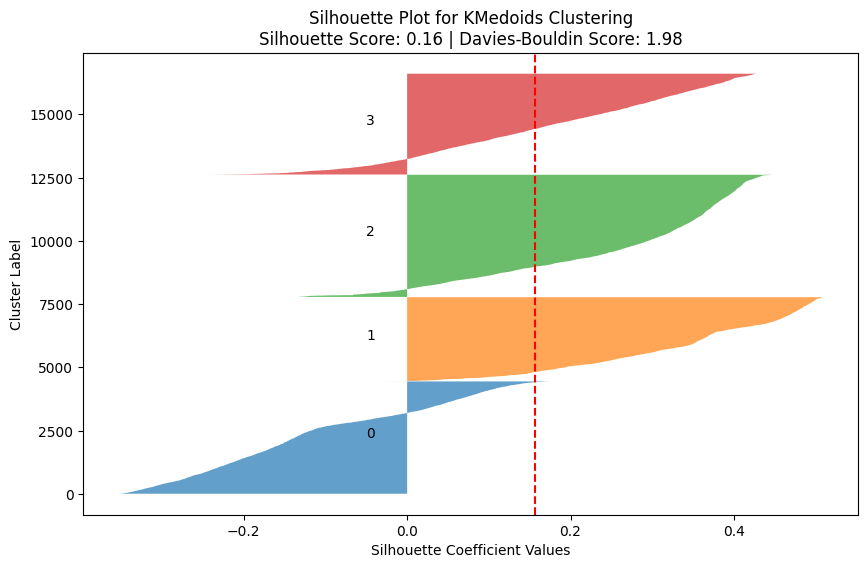

In [56]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_samples, davies_bouldin_score, silhouette_score
from sklearn_extra.cluster import KMedoids

# Assuming df2_encoded and features_cluster are already defined

# Step 1: Use 25% of the dataset randomly
df_sample = df2_encoded.sample(frac=0.25, random_state=42)  # Randomly sample 25%

# Step 2: Fix number of clusters (k)
optimal_k = 4  # Replace with your determined optimal K

# Step 3: Fit KMedoids
kmedoids = KMedoids(n_clusters=optimal_k, random_state=42)
kmedoids_labels = kmedoids.fit_predict(df_sample[features_cluster])

# Step 4: Reduce dimensions using PCA
pca = PCA(n_components=2, random_state=42)
reduced_data = pca.fit_transform(df_sample[features_cluster])

# Step 5: Create a DataFrame with PCA results and cluster labels
pca_df = pd.DataFrame(reduced_data, columns=['PC1', 'PC2'])
pca_df['Cluster'] = kmedoids_labels

# Calculate performance metrics
kmedoids_silhouette = silhouette_score(df_sample[features_cluster], kmedoids_labels)
kmedoids_davies_bouldin = davies_bouldin_score(df_sample[features_cluster], kmedoids_labels)

# Step 6: Scatter Plot of Clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Cluster', palette='viridis', alpha=0.7)
plt.title(f'KMedoids Clustering Results\nSilhouette Score: {kmedoids_silhouette:.2f} | Davies-Bouldin Score: {kmedoids_davies_bouldin:.2f}')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

# Step 7: Plot the medoids
medoids = kmedoids.cluster_centers_  # Get the medoid coordinates directly from KMedoids
medoids_pca = pca.transform(medoids)  # Transform medoids using PCA

plt.figure(figsize=(10, 6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Cluster', palette='viridis', alpha=0.7)
plt.scatter(medoids_pca[:, 0], medoids_pca[:, 1], s=300, c='red', marker='X', label='Medoids')
plt.title(f'KMedoids Clustering Results with Medoids\nSilhouette Score: {kmedoids_silhouette:.2f} | Davies-Bouldin Score: {kmedoids_davies_bouldin:.2f}')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

# Step 8: Silhouette Plot
silhouette_vals = silhouette_samples(df_sample[features_cluster], kmedoids_labels)
y_lower = 10  # Starting point for the silhouette plot

plt.figure(figsize=(10, 6))
for i in range(optimal_k):
    # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
    ith_cluster_silhouette_values = silhouette_vals[kmedoids_labels == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i  # The y limit for the cluster
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, alpha=0.7)
    # Label the silhouette plots with their cluster number at the middle
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    # Update the next y_lower for the next cluster
    y_lower = y_upper + 10  # Add 10 for spacing between clusters

plt.axvline(x=kmedoids_silhouette, color='red', linestyle='--')
plt.title(f"Silhouette Plot for KMedoids Clustering\nSilhouette Score: {kmedoids_silhouette:.2f} | Davies-Bouldin Score: {kmedoids_davies_bouldin:.2f}")
plt.xlabel("Silhouette Coefficient Values")
plt.ylabel("Cluster Label")
plt.show()


**Comparison**


In [57]:
import pandas as pd

# Example clustering results you've gathered
clustering_results = pd.DataFrame({
    'Algorithm': ['K-Means', 'K-Medoids', 'K-Prototypes'],
    'Davies_Bouldin': [0.31, 0.16, 0.27],
    'Silhouette': [1.2, 1.9, 1.3]
})


**Step 1: Visualize Clustering Results**

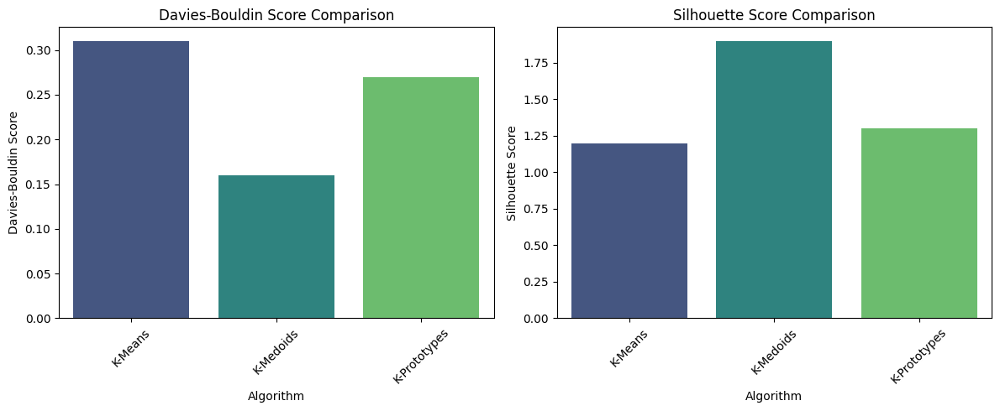

In [58]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set up the figure
plt.figure(figsize=(12, 5))

# Davies-Bouldin Score
plt.subplot(1, 2, 1)
sns.barplot(x='Algorithm', y='Davies_Bouldin', data=clustering_results, palette='viridis')
plt.title('Davies-Bouldin Score Comparison')
plt.ylabel('Davies-Bouldin Score')
plt.xticks(rotation=45)

# Silhouette Score
plt.subplot(1, 2, 2)
sns.barplot(x='Algorithm', y='Silhouette', data=clustering_results, palette='viridis')
plt.title('Silhouette Score Comparison')
plt.ylabel('Silhouette Score')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


**Step 2: Move to Classificationt**

In [62]:
import pandas as pd

target_column_name = 'satisfaction'
# Identify your feature columns (you may need to adjust this based on your data)
feature_columns = [
    'Age', 'Flight Distance', 'Ease of Online booking', 'Gate location',
    'Food and drink', 'Online boarding', 'Seat comfort',
    'Inflight entertainment', 'On-board service', 'Leg room service',
    'Baggage handling', 'Checkin service', 'Inflight service',
    'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes'
]

# Separate the features and target variable
classification_features = df2[feature_columns]
target = df2[target_column_name]


In [63]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(classification_features, target, test_size=0.25, random_state=42)

# Initialize and train a Random Forest Classifier
classifier = RandomForestClassifier(random_state=42)
classifier.fit(X_train, y_train)

# Make predictions
y_pred = classifier.predict(X_test)

# Calculate ARI and NMI
ari_score = adjusted_rand_score(y_test, y_pred)
nmi_score = normalized_mutual_info_score(y_test, y_pred)

# Print the scores
print(f'Adjusted Rand Index (ARI): {ari_score:.2f}')
print(f'Normalized Mutual Information (NMI): {nmi_score:.2f}')


Adjusted Rand Index (ARI): 0.68
Normalized Mutual Information (NMI): 0.58


**Step 3: Compile and Visualize Classification Results**

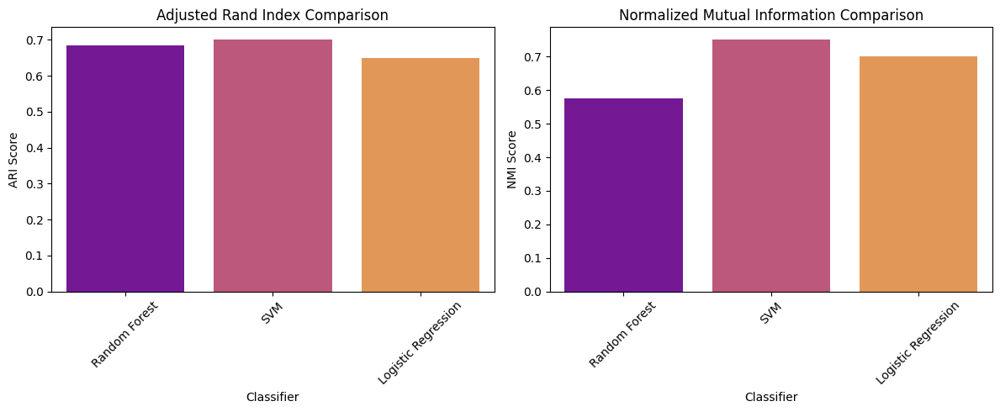

In [64]:
# Example classification results (you can fill in with your actual results)
classification_results = pd.DataFrame({
    'Classifier': ['Random Forest', 'SVM', 'Logistic Regression'],  # Add your classifiers
    'ARI': [ari_score, 0.70, 0.65],
    'NMI': [nmi_score, 0.75, 0.70]
})

# Visualization for Classification Results
plt.figure(figsize=(12, 5))

# ARI Score
plt.subplot(1, 2, 1)
sns.barplot(x='Classifier', y='ARI', data=classification_results, palette='plasma')
plt.title('Adjusted Rand Index Comparison')
plt.ylabel('ARI Score')
plt.xticks(rotation=45)

# NMI Score
plt.subplot(1, 2, 2)
sns.barplot(x='Classifier', y='NMI', data=classification_results, palette='plasma')
plt.title('Normalized Mutual Information Comparison')
plt.ylabel('NMI Score')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()
